In [1]:
#mount your drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [13]:
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025')

In [14]:
ls

CenterNet_Training/      models/            yolo12l.onnx  yolo_nas_l.pt
COCO_Format/             my_dataset/        yolo12l.pt    yolov10n.onnx
cow_detection_results/   predicted_images/  yolo12m.onnx  yolov10n.pt
dataset_tf_2025/         retinanet/         yolo12m.pt    yolov5/
data.yaml                runs/              yolo12n.onnx  yolov7/
DETR-Livestock/          SSD_Training/      yolo12n.pt    yolov7-tiny.pt
DJI_0486.MP4             testing_images/    yolo12s.onnx  yolov8s.onnx
DJI_0618.MP4             ultralytics/       yolo12s.pt    yolov8s.pt
EfficientDet_Training/   yolo11n.pt         yolo12x.onnx  yolov8x.onnx
Faster-RCNN_checkpoint/  yolo11x.onnx       yolo12x.pt    yolov8x.pt
labels.txt               yolo11x.pt         YOLO-NAS/     yolov9e.pt


YOLOv7 Model

In [15]:
!git clone https://github.com/WongKinYiu/yolov7

fatal: destination path 'yolov7' already exists and is not an empty directory.


In [16]:
%cd /content/drive/MyDrive/LivestockDetection2025/yolov7
!pip install -r requirements.txt

/content/drive/MyDrive/LivestockDetection2025/yolov7
  Using cached numpy-1.23.5-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.3 kB)
Using cached numpy-1.23.5-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.1 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
xarray 2025.7.1 requires numpy>=1.26, but you have numpy 1.23.5 which is incompatible.
arviz 0.22.0 requires numpy>=1.26.0, but you have numpy 1.23.5 which is incompatible.
ydf 0.13.0 requires protobuf<7.0.0,>=5.29.1, but you have protobuf 4.21.2 which is incompatible.
scikit-image 0.25.2 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.
jaxlib 0.5.3 requires numpy>=1.25, but you have numpy 1.23.5

In [17]:
!pip install numpy==1.26.4 --upgrade

  Using cached numpy-1.26.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (61 kB)
Using cached numpy-1.26.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.3 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.23.5
    Uninstalling numpy-1.23.5:
      Successfully uninstalled numpy-1.23.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ydf 0.13.0 requires protobuf<7.0.0,>=5.29.1, but you have protobuf 4.21.2 which is incompatible.
opencv-contrib-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
tensorflow 2.19.0 requ

In [20]:
!pip uninstall -y wandb


Found existing installation: wandb 0.21.0
Uninstalling wandb-0.21.0:
  Successfully uninstalled wandb-0.21.0


In [22]:
!pip install torch==2.5.1 torchvision==0.20.1 torchaudio==2.5.1 --force-reinstall

  Using cached nvidia_cuda_nvrtc_cu12-12.4.127-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.4.127-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.4.127-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-9.1.0.70-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.4.5.8-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.2.1.3-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.5.147-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.6.1.9-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.3.1.170-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.21.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvjitlink_cu

In [25]:
!find /content/drive/MyDrive/LivestockDetection2025/yolov7 -name "*.cache" -delete


In [28]:
%cd /content/drive/MyDrive/LivestockDetection2025/yolov7

!python train.py --batch 8 --epochs 100  --data /content/drive/MyDrive/LivestockDetection2025/yolov7/data/data.yaml --weights yolov7.pt

/content/drive/MyDrive/LivestockDetection2025/yolov7
2025-08-09 22:57:35.061551: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-09 22:57:35.079659: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1754780255.101094   10767 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1754780255.107678   10767 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1754780255.124456   10767 computation_placer.cc:177] computation placer alread

In [29]:
#TensorBoard
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7

<IPython.core.display.Javascript object>

In [30]:
!python export.py --weights runs/train/exp7/weights/best.pt --include onnx --simplify

Traceback (most recent call last):
  File "/content/drive/MyDrive/LivestockDetection2025/yolov7/export.py", line 17, in <module>
    from utils.add_nms import RegisterNMS
  File "/content/drive/MyDrive/LivestockDetection2025/yolov7/utils/add_nms.py", line 2, in <module>
    import onnx
ModuleNotFoundError: No module named 'onnx'


In [6]:
!pwd

/content/drive/MyDrive/LivestockDetection2025/yolov7


In [33]:
#from ultralytics import YOLO
from IPython.display import Image

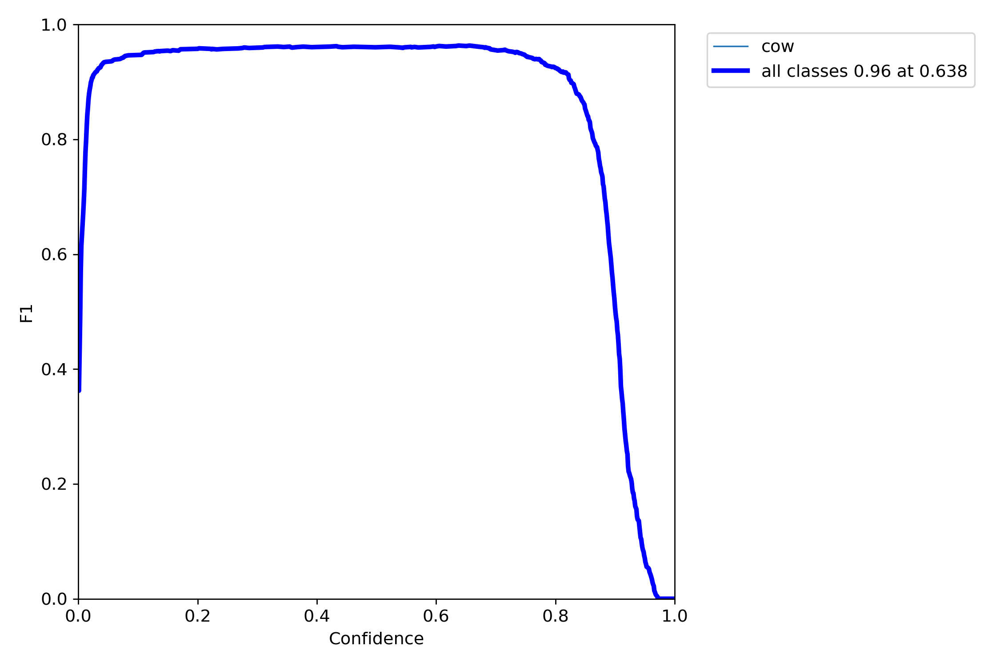

In [34]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/F1_curve.png", width=600)

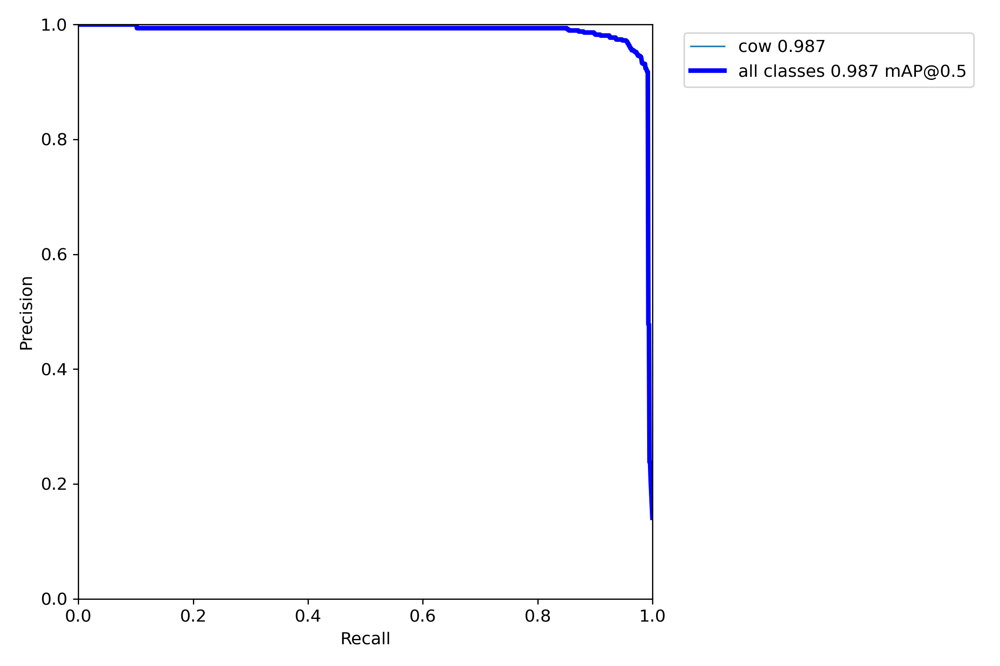

In [35]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/PR_curve.png", width=600)

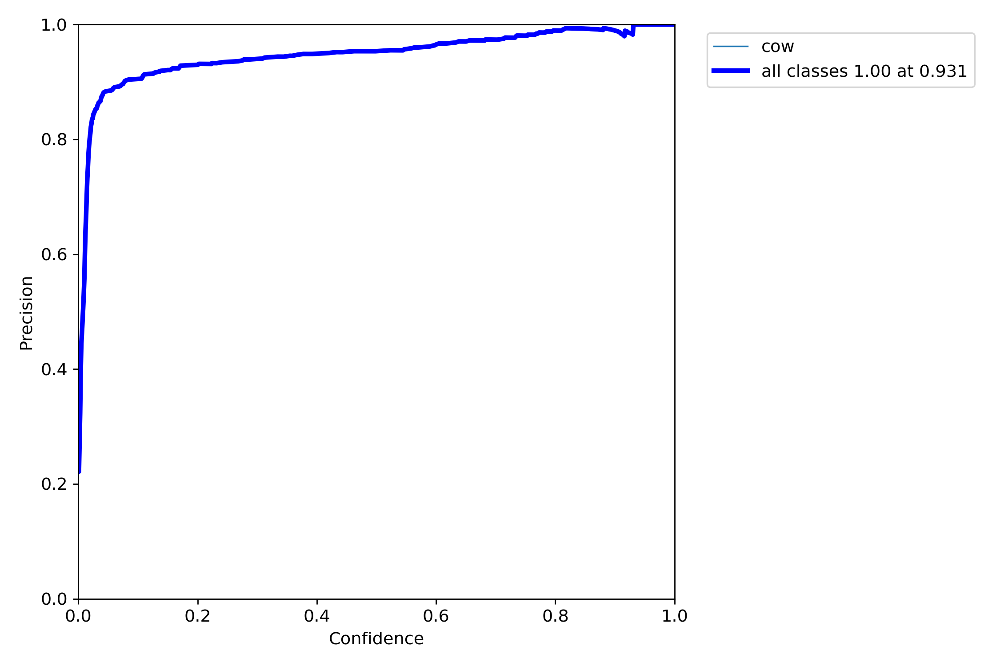

In [36]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/P_curve.png", width=600)

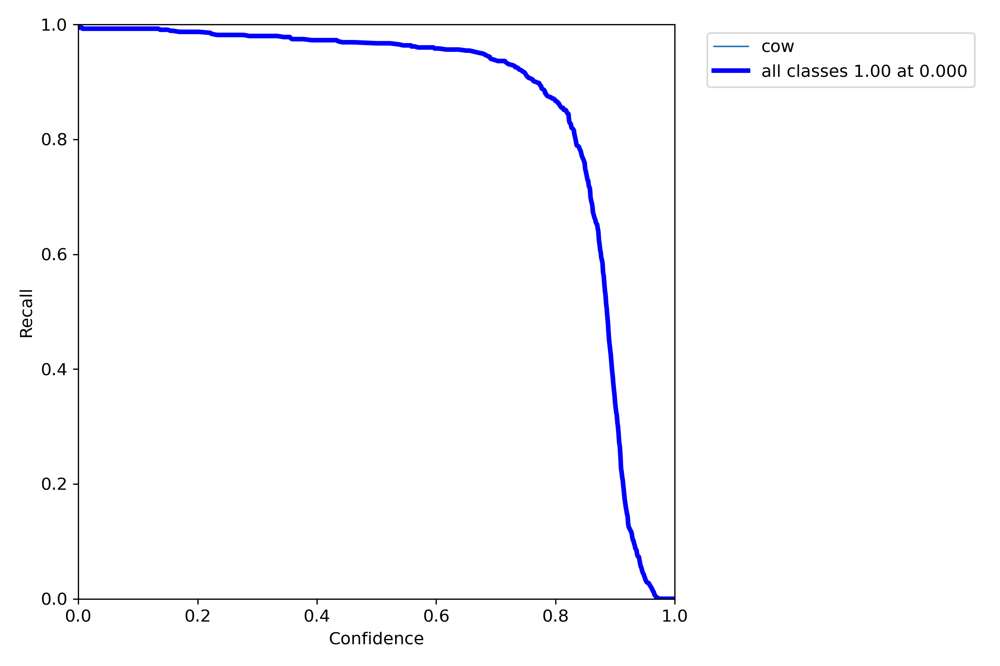

In [37]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/R_curve.png", width=600)

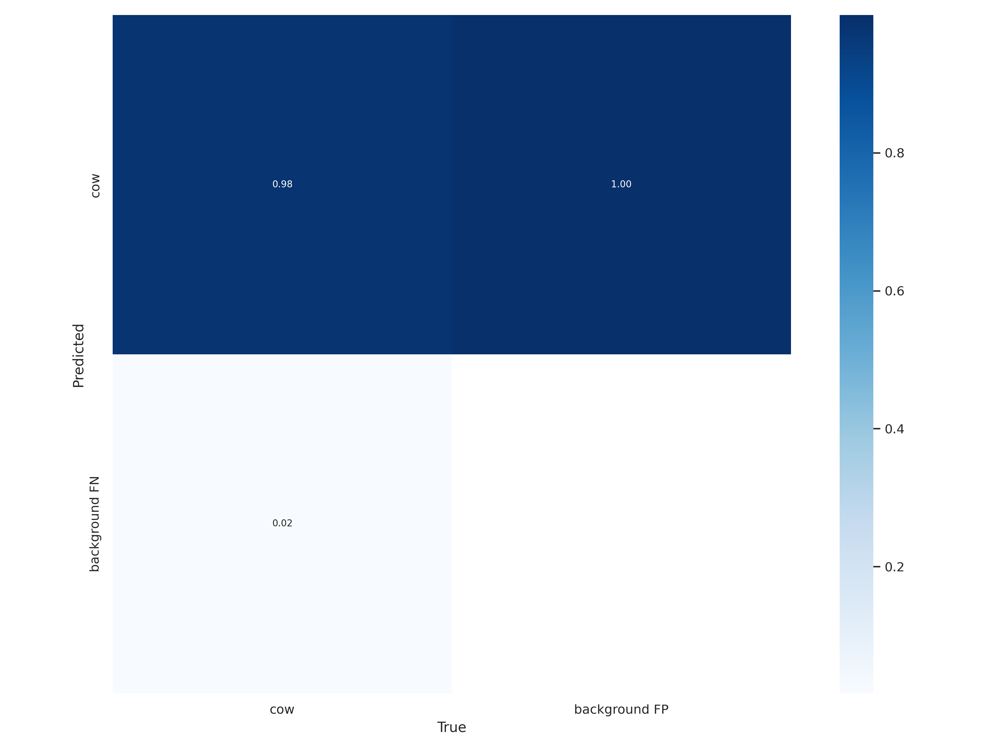

In [38]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/confusion_matrix.png", width=600)

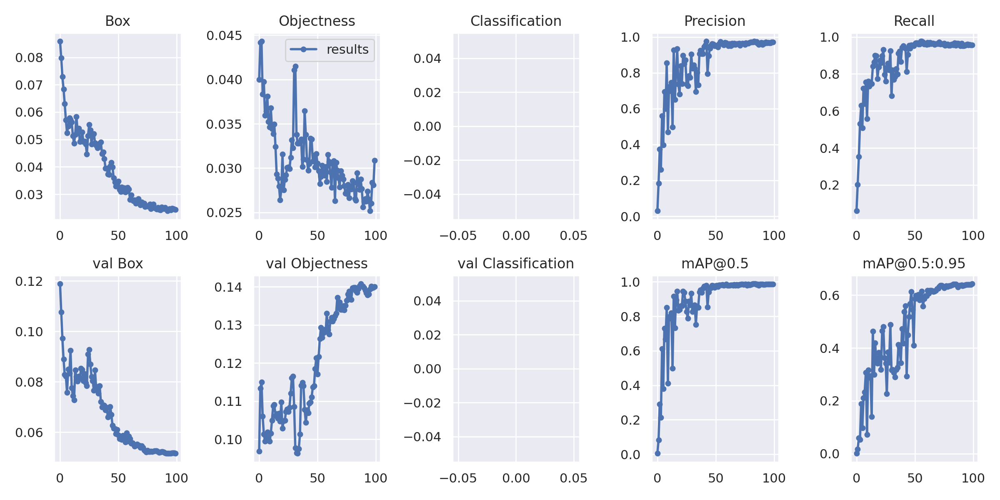

In [39]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/results.png", width=600)

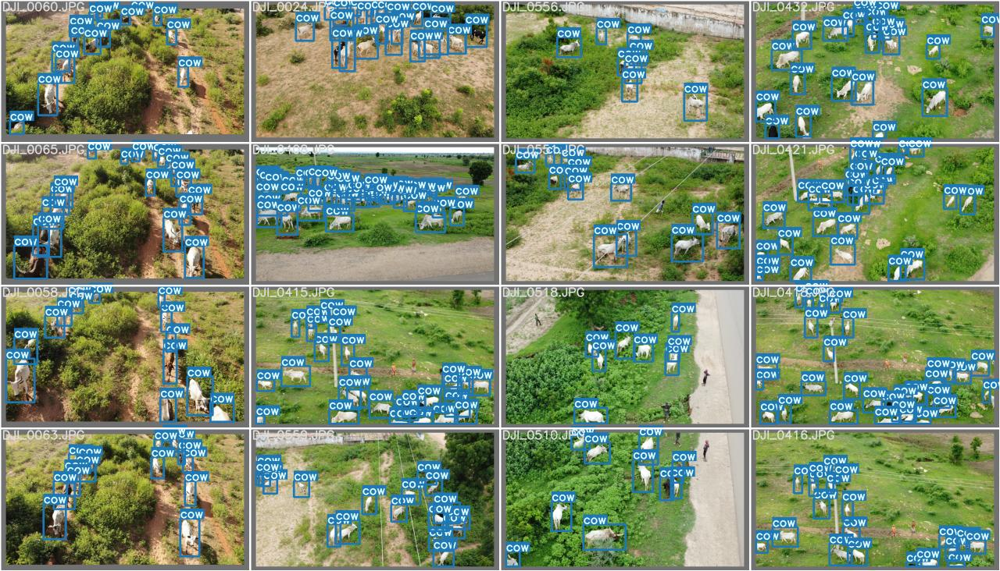

In [40]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/test_batch0_labels.jpg", width=600)

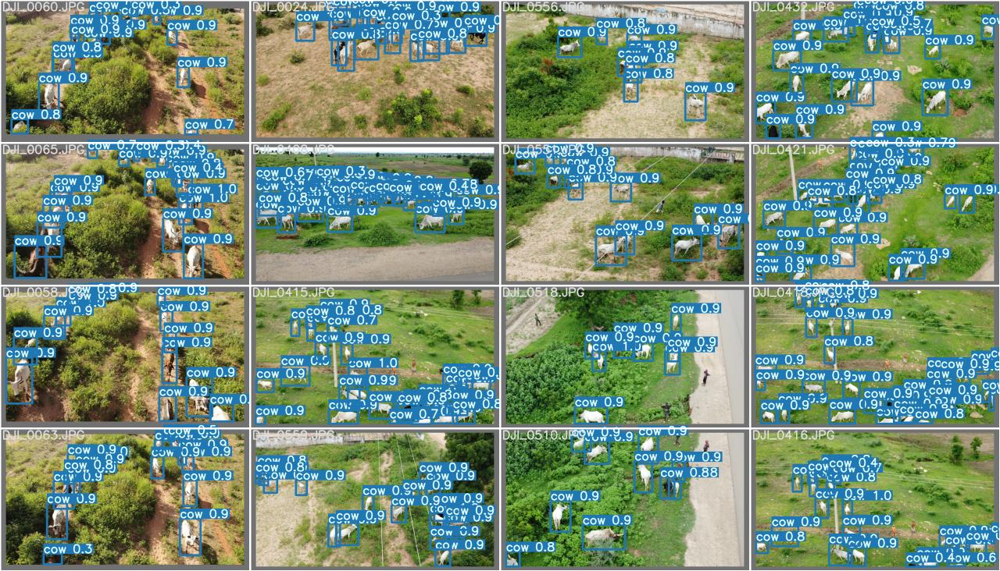

In [41]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/test_batch0_pred.jpg", width=600)

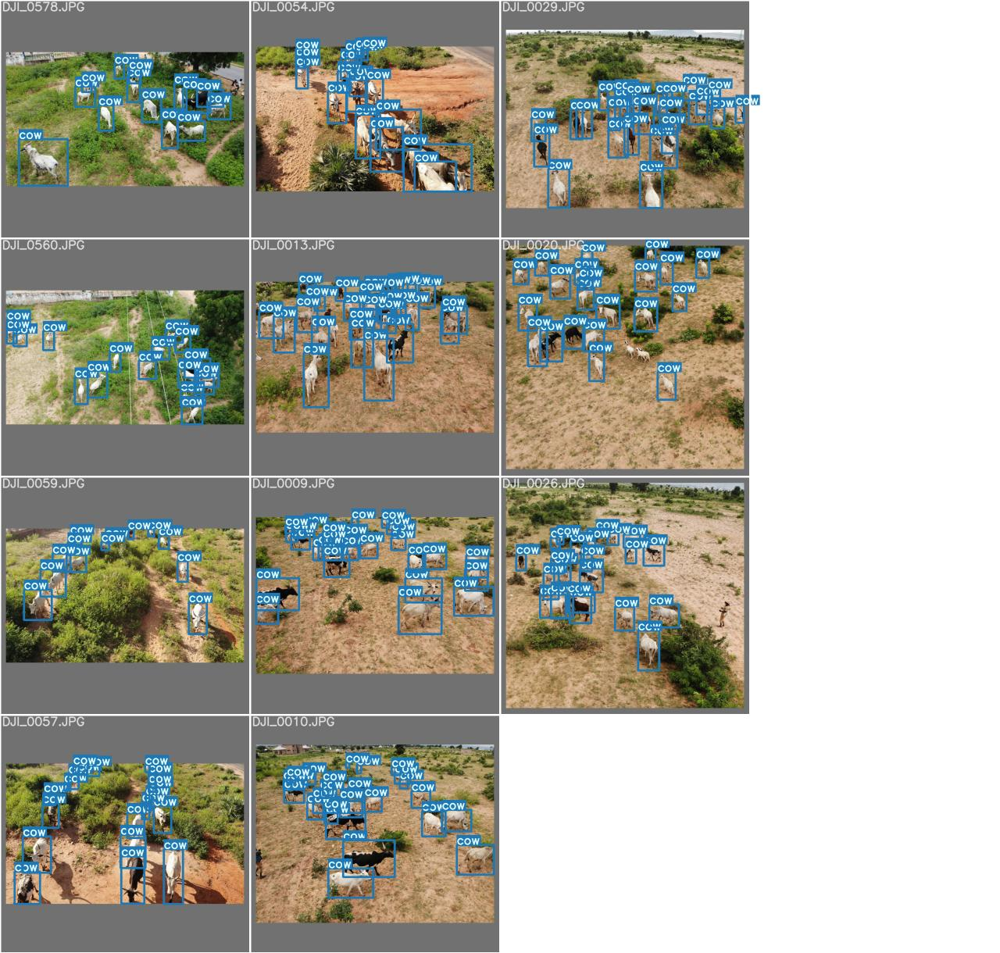

In [42]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/test_batch1_labels.jpg", width=600)

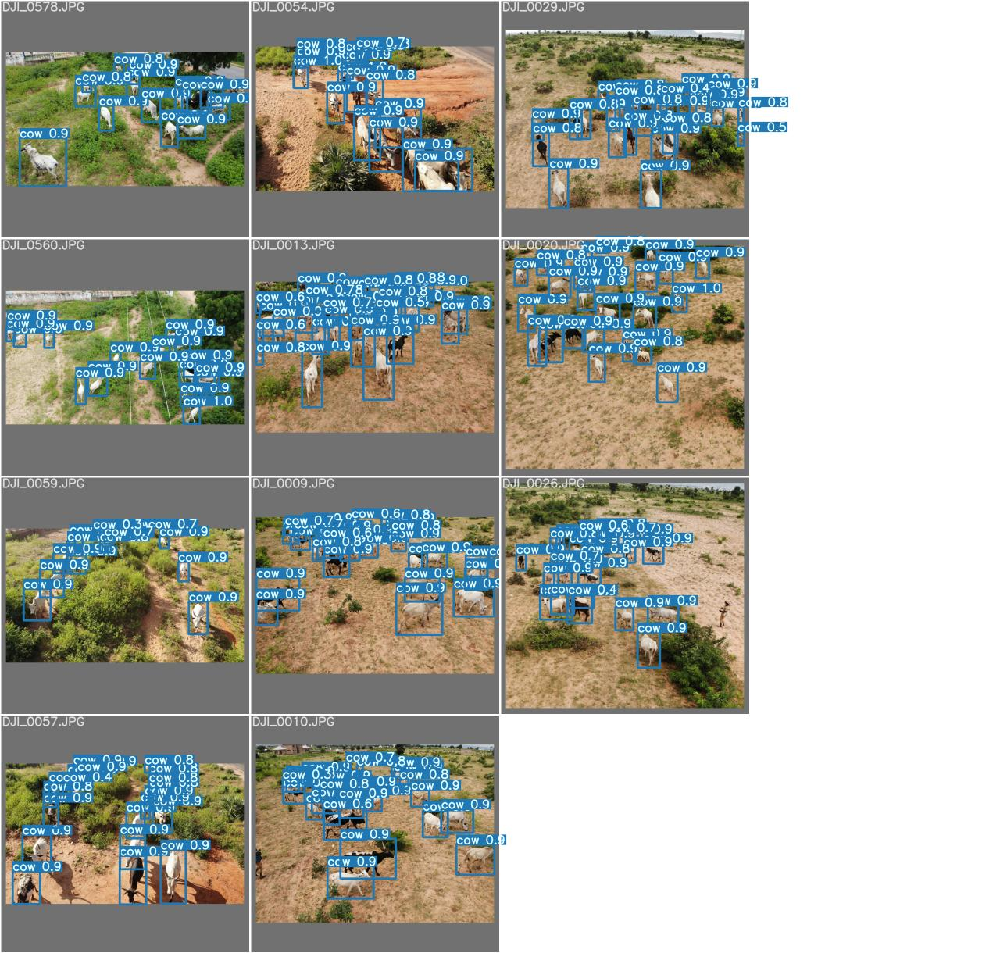

In [43]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/test_batch1_pred.jpg", width=600)

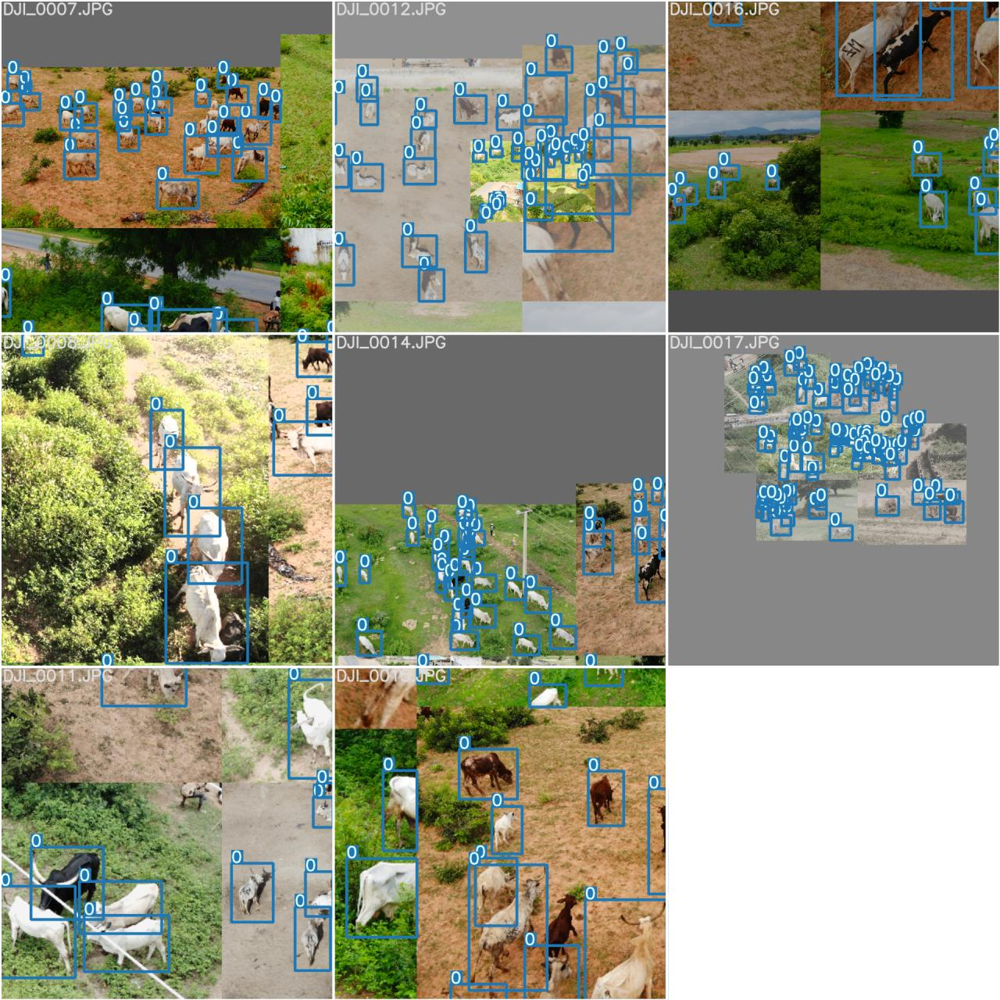

In [44]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch0.jpg", width=600)

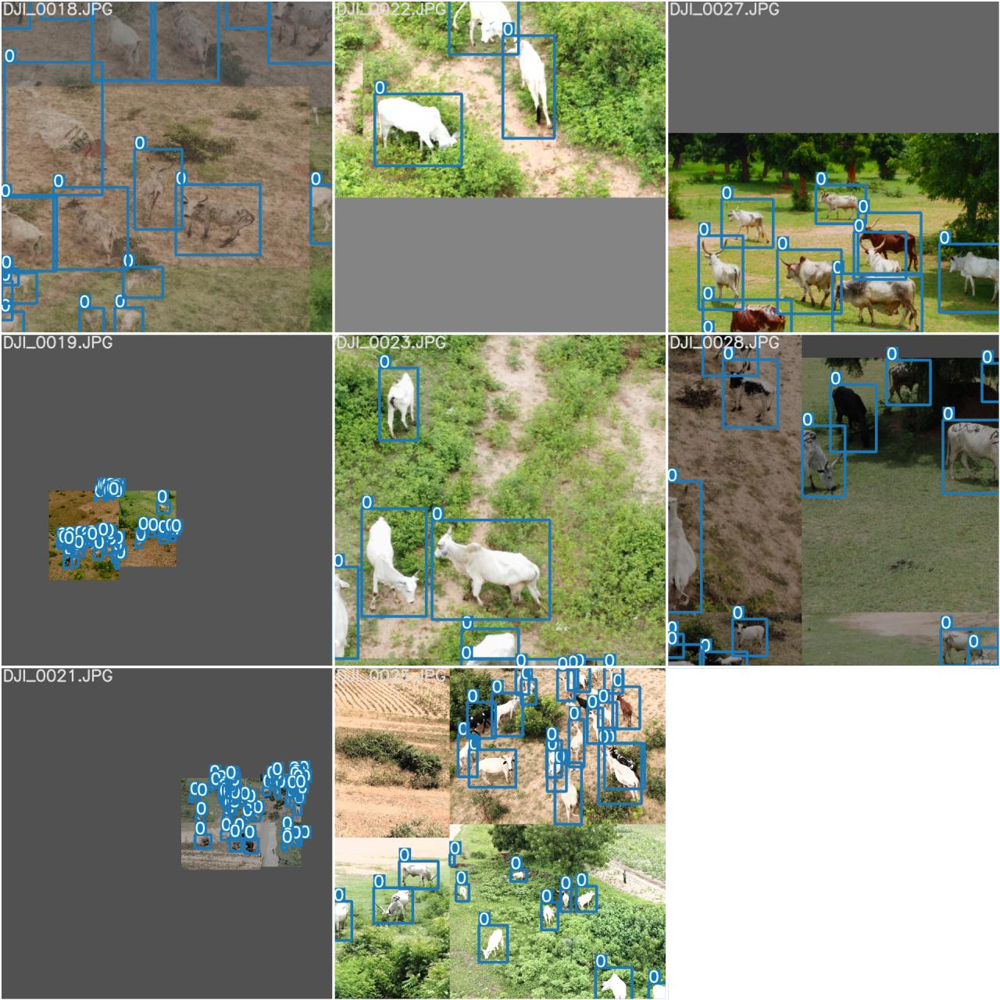

In [45]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch1.jpg", width=600)

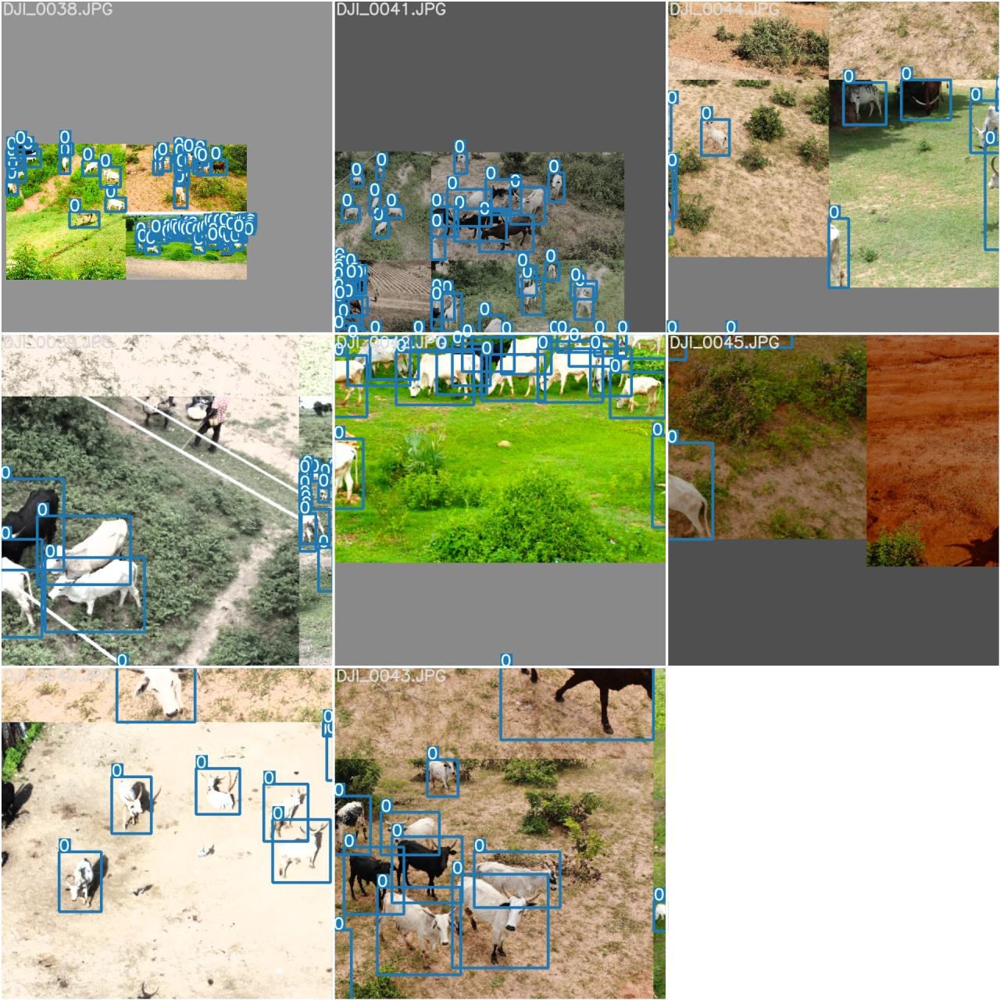

In [47]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch3.jpg", width=600)

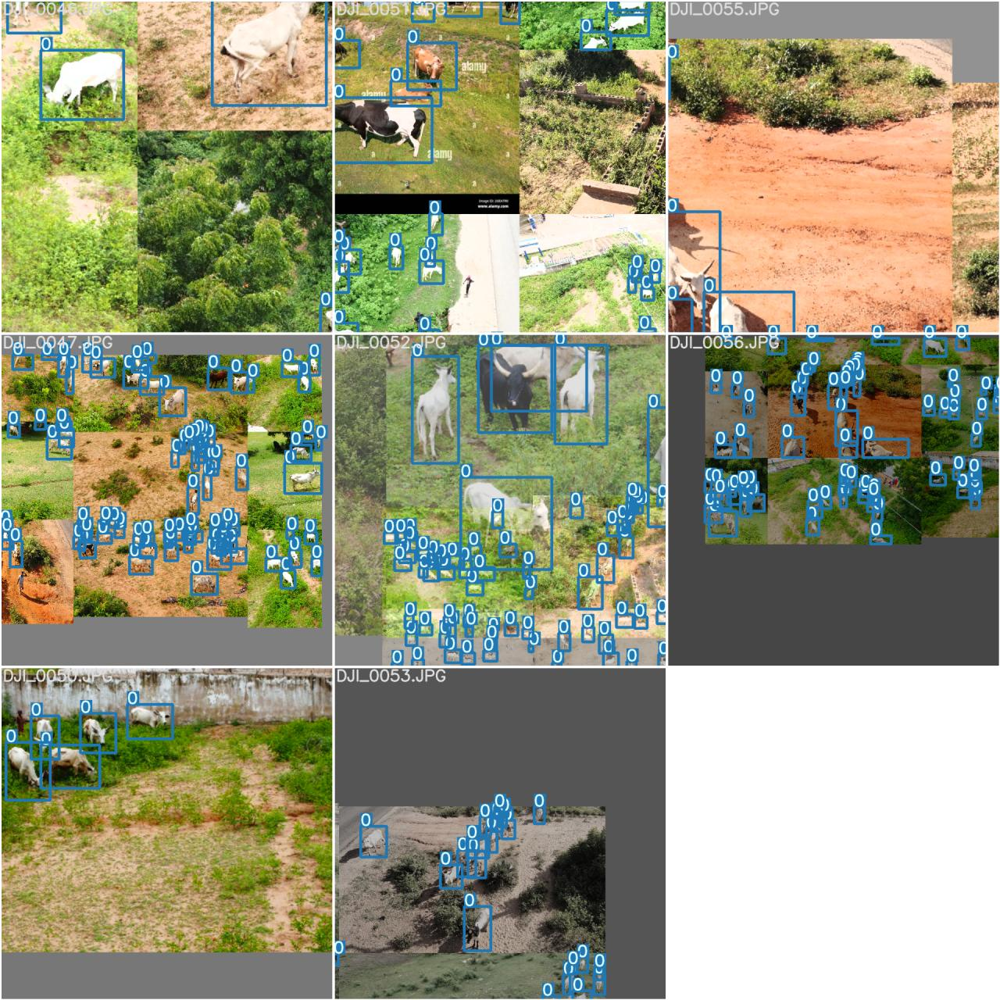

In [48]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch4.jpg", width=600)

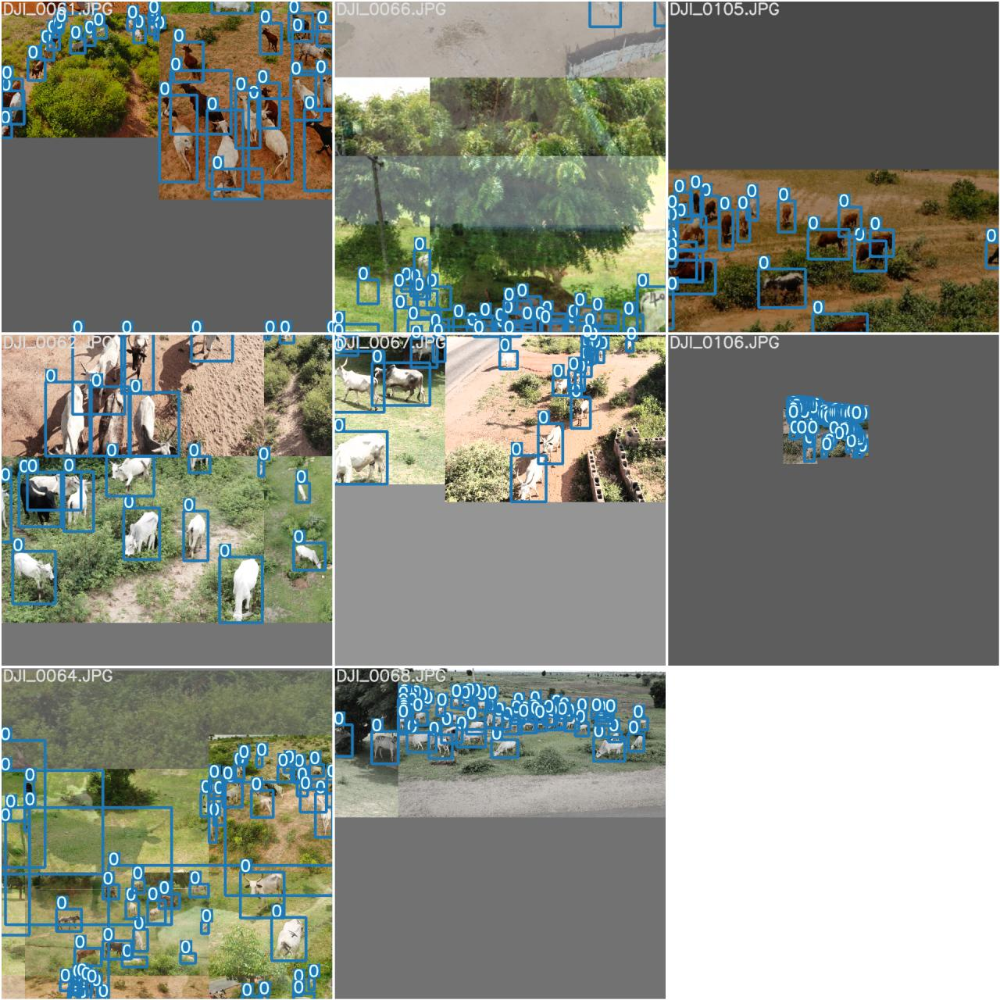

In [49]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch5.jpg", width=600)

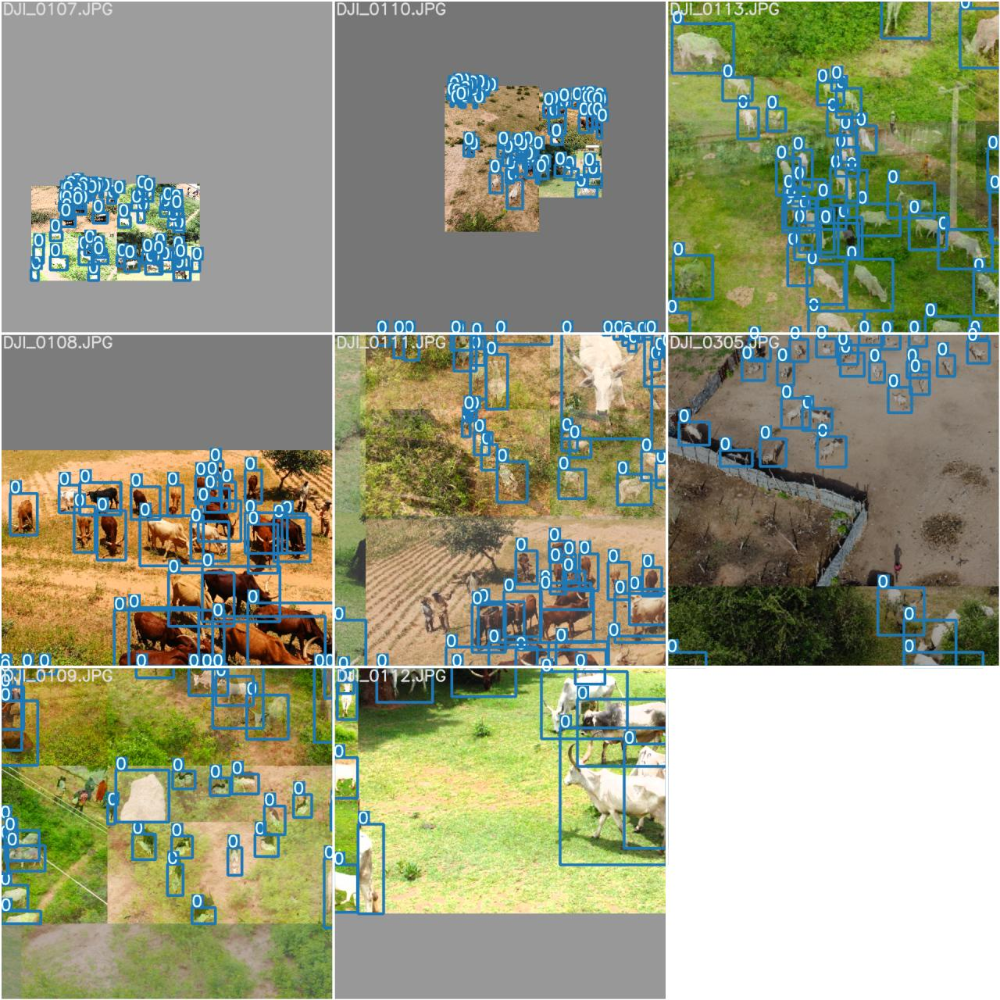

In [50]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch6.jpg", width=600)

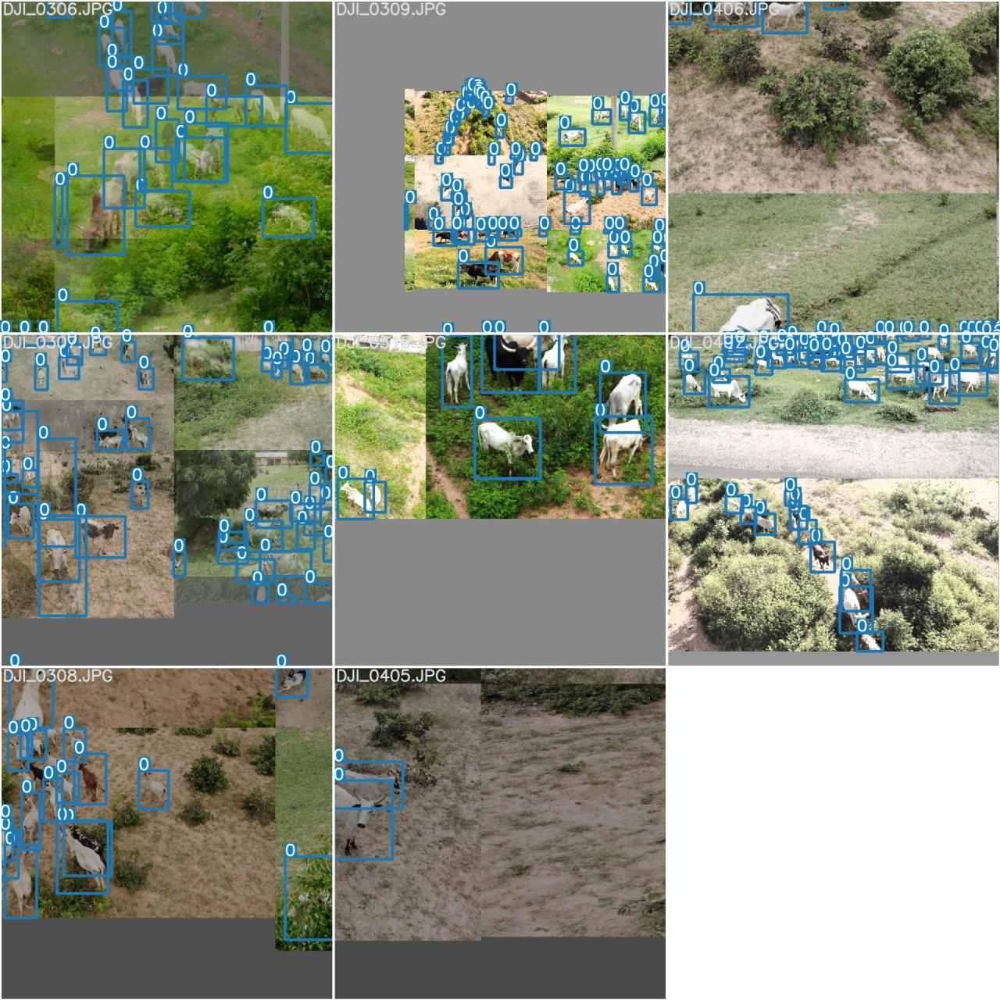

In [51]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch7.jpg", width=600)

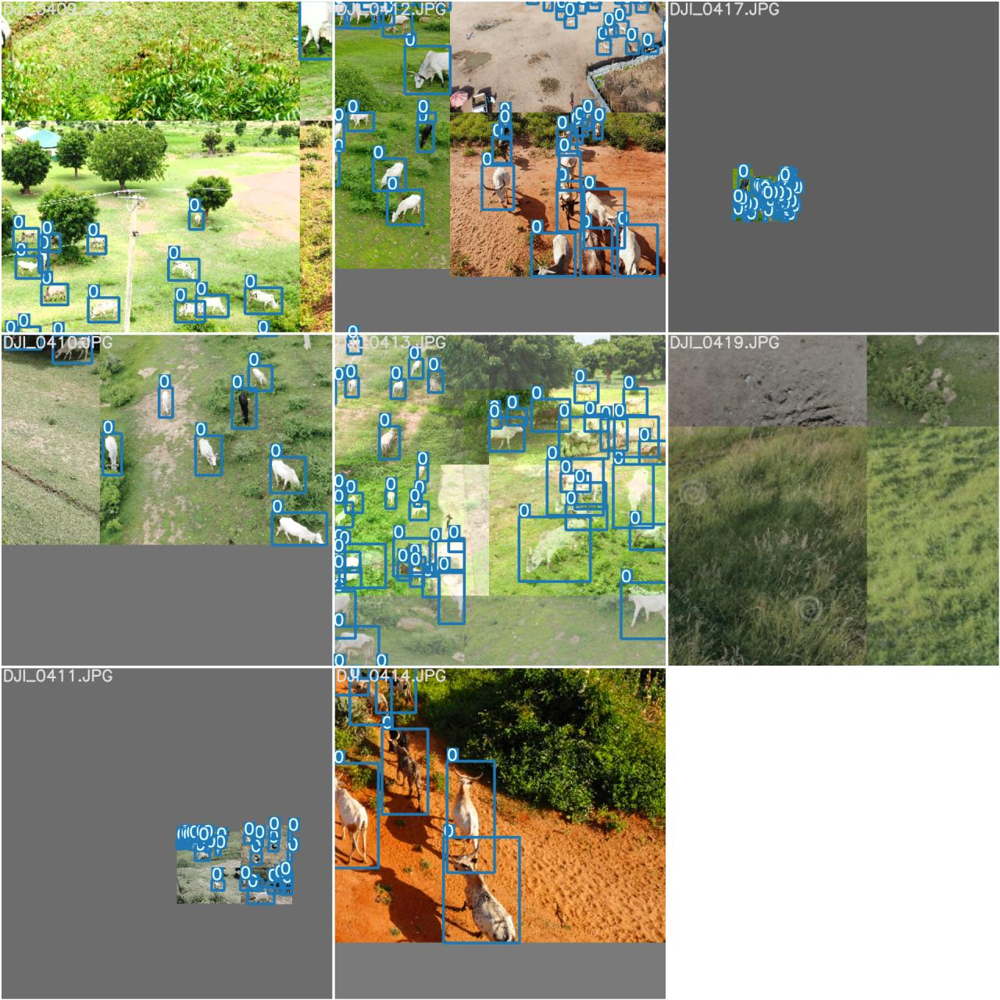

In [52]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch8.jpg", width=600)

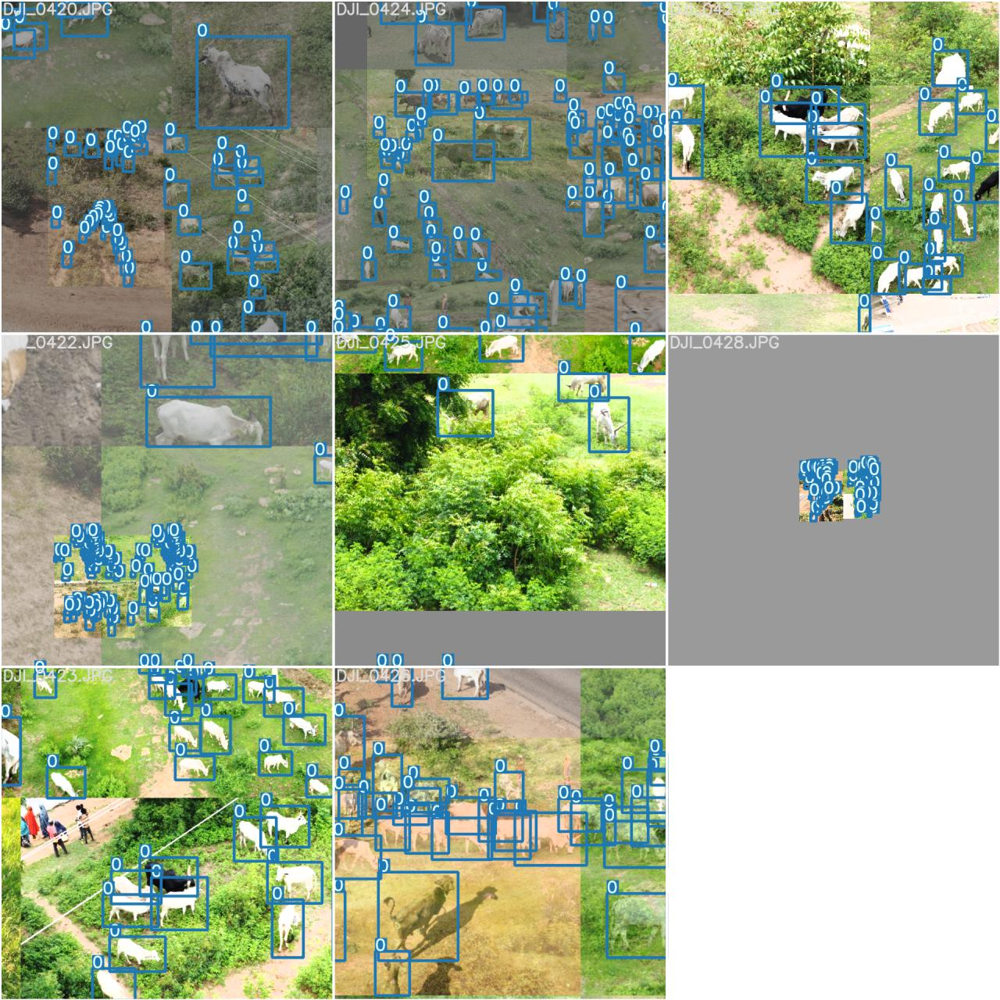

In [53]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/train_batch9.jpg", width=600)

In [58]:
# Ensure we are in the YOLOv5 directory
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025/yolov7')

# Run inference using the modified detect.py script
!python detect.py --weights /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/weights/best.pt --source /content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0012.JPG

Namespace(weights=['/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/weights/best.pt'], source='/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0012.JPG', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40506.8125MB)

/content/drive/MyDrive/LivestockDetection2025/yolov7/models/experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default va

In [59]:
# Ensure we are in the YOLOv5 directory
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025/yolov7')

# Run inference using the modified detect.py script
!python detect.py --weights /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/weights/best.pt --source /content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0305.JPG

Namespace(weights=['/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/weights/best.pt'], source='/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0305.JPG', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40506.8125MB)

/content/drive/MyDrive/LivestockDetection2025/yolov7/models/experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default va

In [60]:
# Ensure we are in the YOLOv5 directory
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025/yolov7')

# Run inference using the modified detect.py script
!python detect.py --weights /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/weights/best.pt --source /content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0450.JPG

Namespace(weights=['/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/exp7/weights/best.pt'], source='/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0450.JPG', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40506.8125MB)

/content/drive/MyDrive/LivestockDetection2025/yolov7/models/experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default va

YOLOV7-Tiny Training

In [61]:
!python train.py --weights yolov7.pt --data "/content/drive/MyDrive/LivestockDetection2025/yolov7/data/data.yaml" --workers 4 --batch-size 4 --img 416 --cfg /content/drive/MyDrive/LivestockDetection2025/yolov7/cfg/training/yolov7-tiny.yaml --name yolov7 --hyp data/hyp.scratch.p5.yaml --epochs 100

2025-08-10 00:12:50.054729: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-10 00:12:50.073694: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1754784770.095889   31418 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1754784770.102480   31418 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1754784770.119880   31418 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [62]:
#TensorBoard
%load_ext tensorboard
%tensorboard --logdir runs/train/yolov77

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [63]:
#from ultralytics import YOLO
from IPython.display import Image

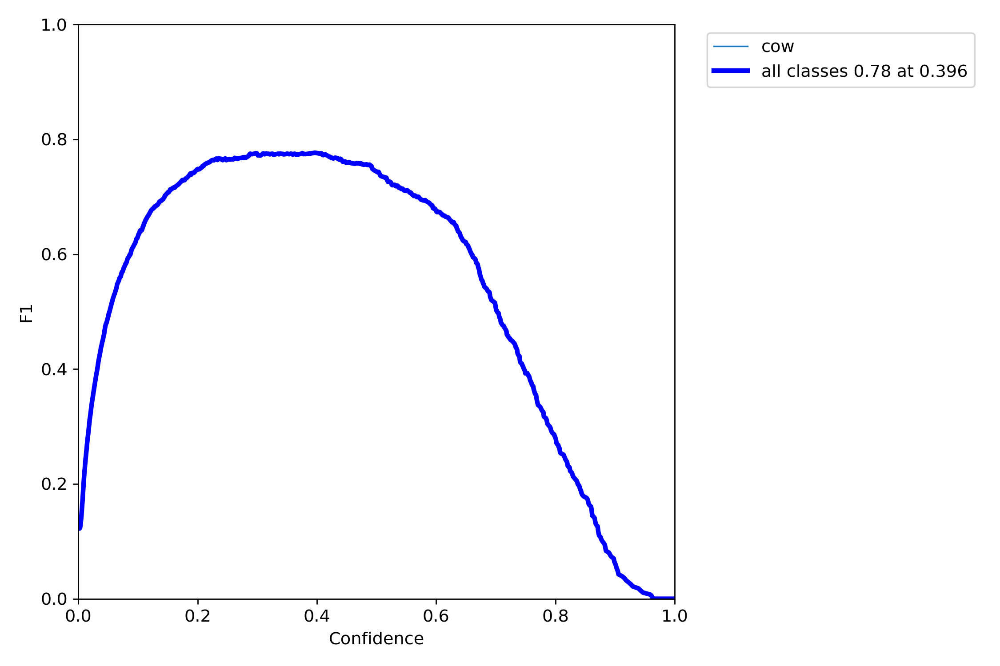

In [64]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/F1_curve.png", width=600)

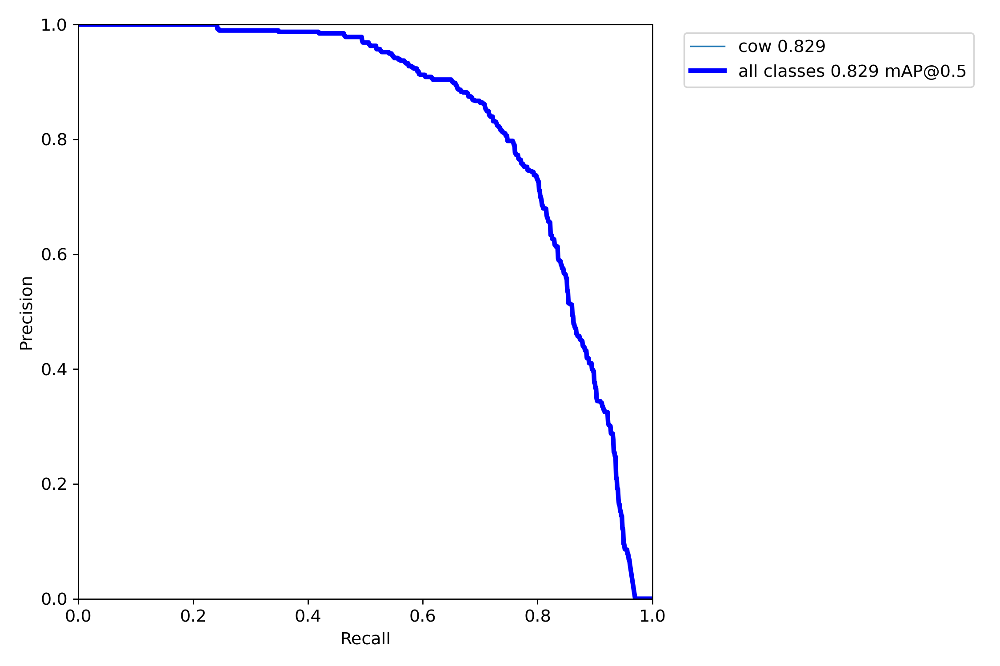

In [65]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/PR_curve.png", width=600)

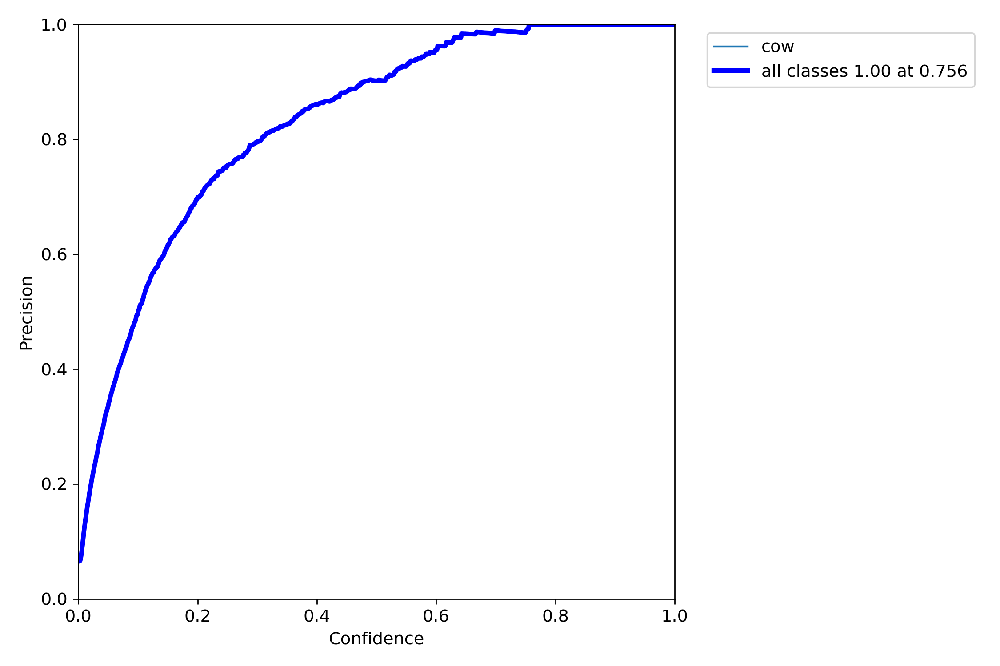

In [66]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/P_curve.png", width=600)

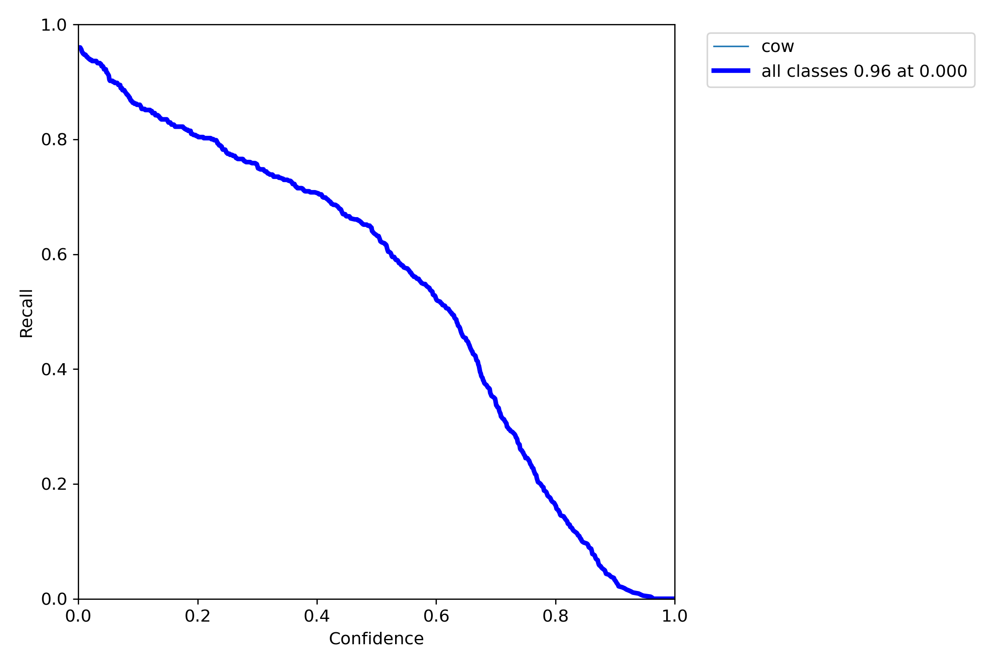

In [67]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/R_curve.png", width=600)

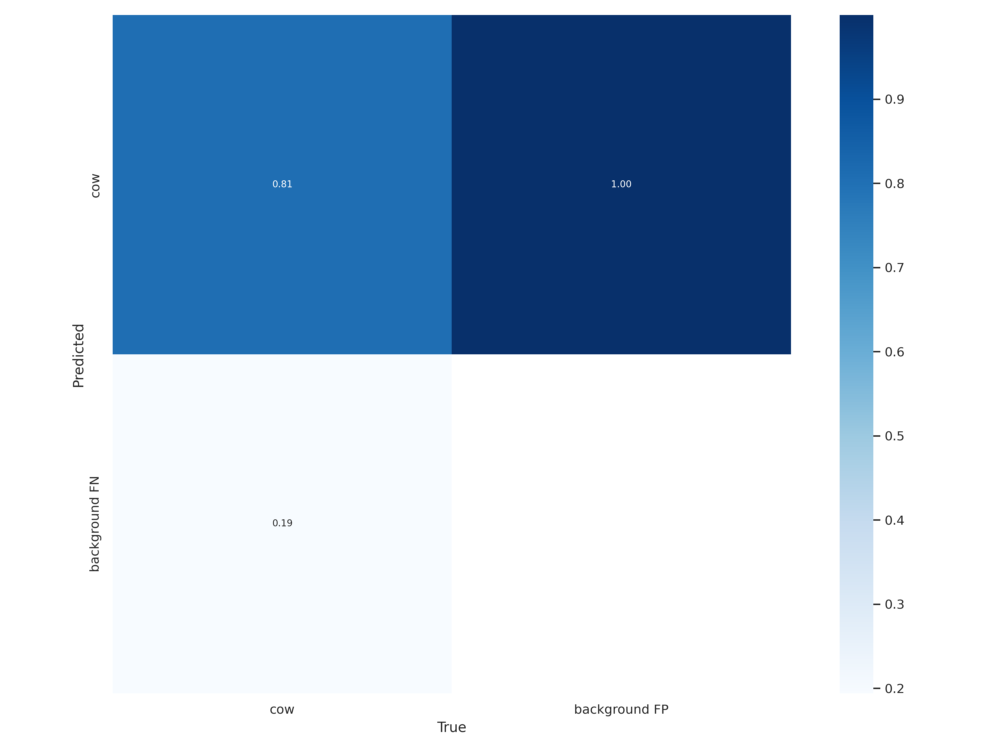

In [68]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/confusion_matrix.png", width=600)

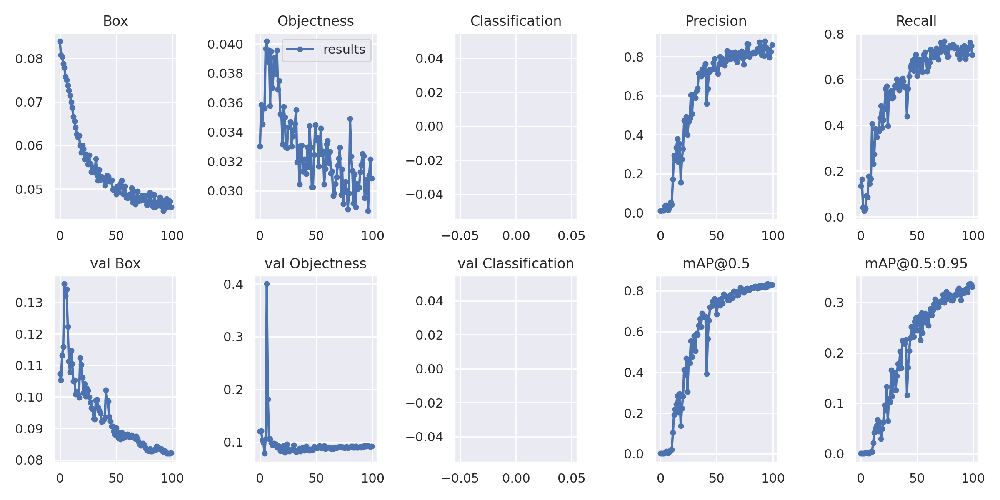

In [69]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/results.png", width=600)

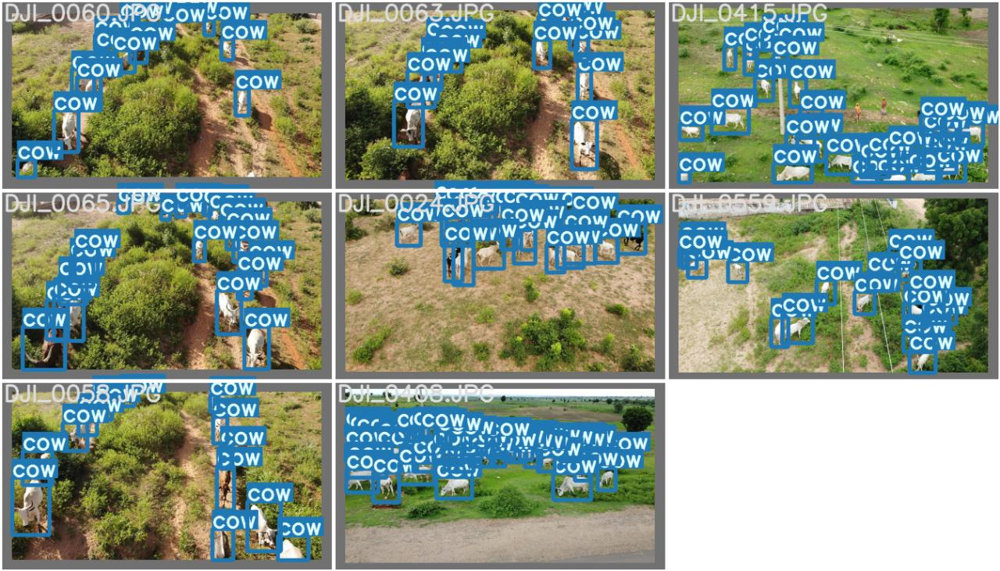

In [70]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch0_labels.jpg", width=600)

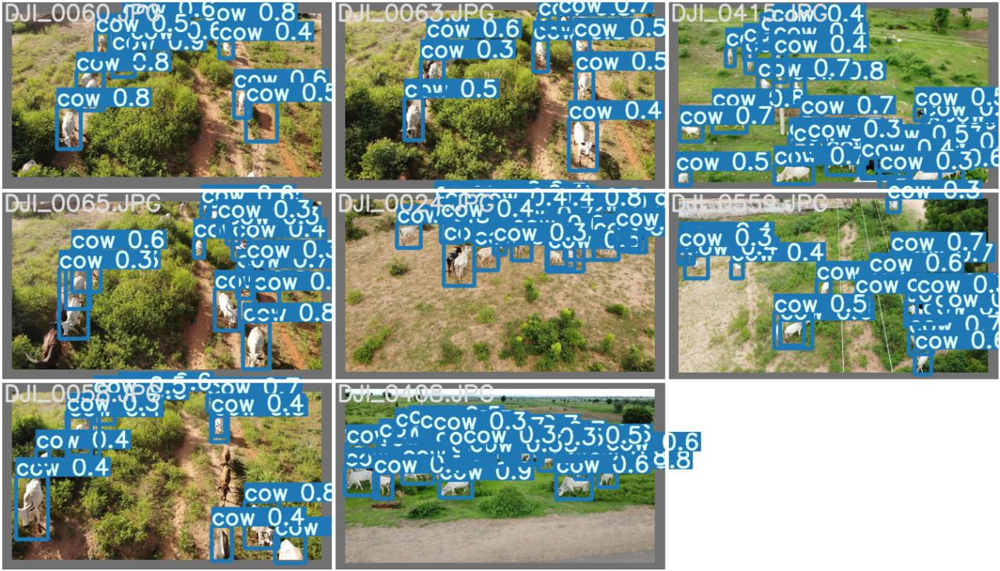

In [71]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch0_pred.jpg", width=600)

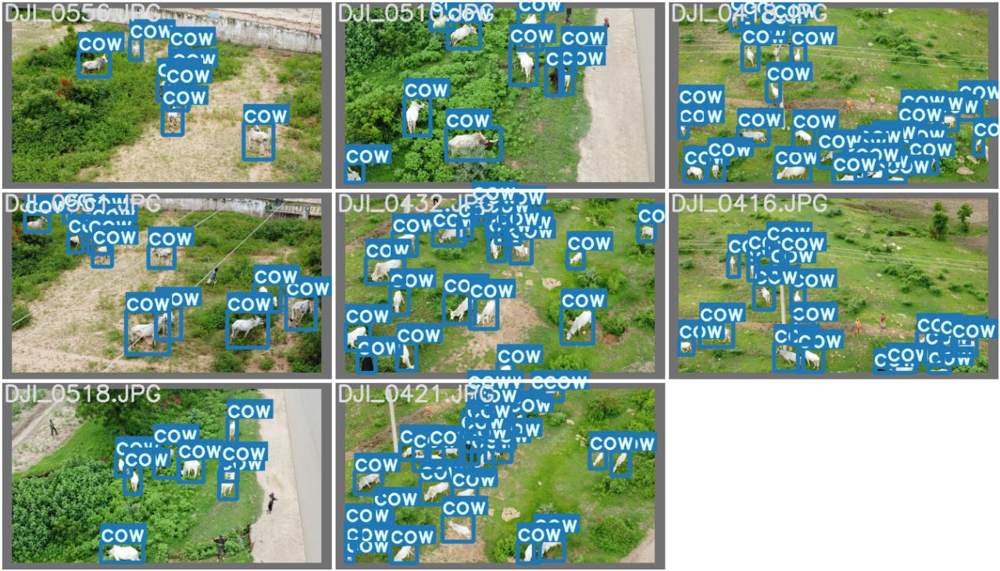

In [72]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch1_labels.jpg", width=600)

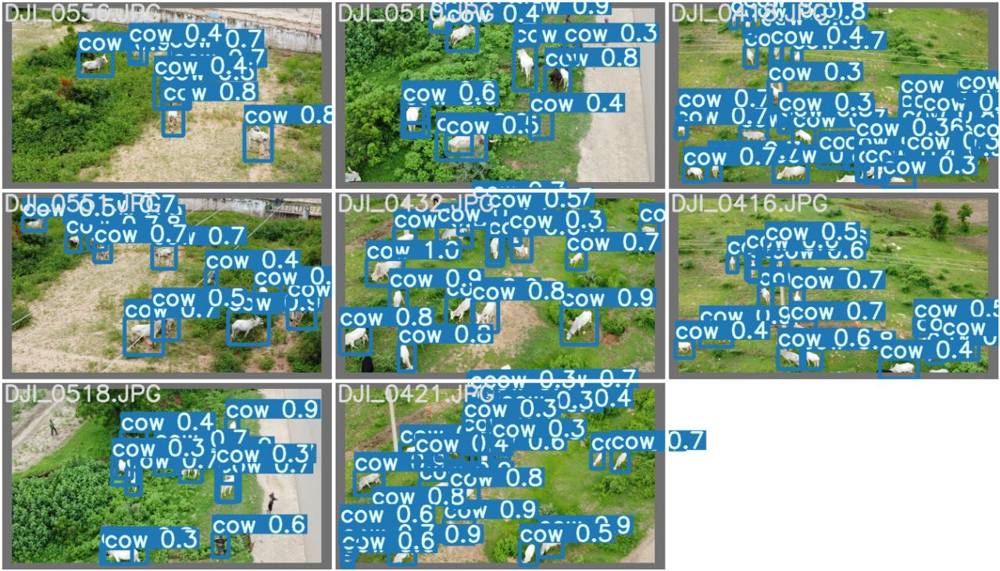

In [73]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch1_pred.jpg", width=600)

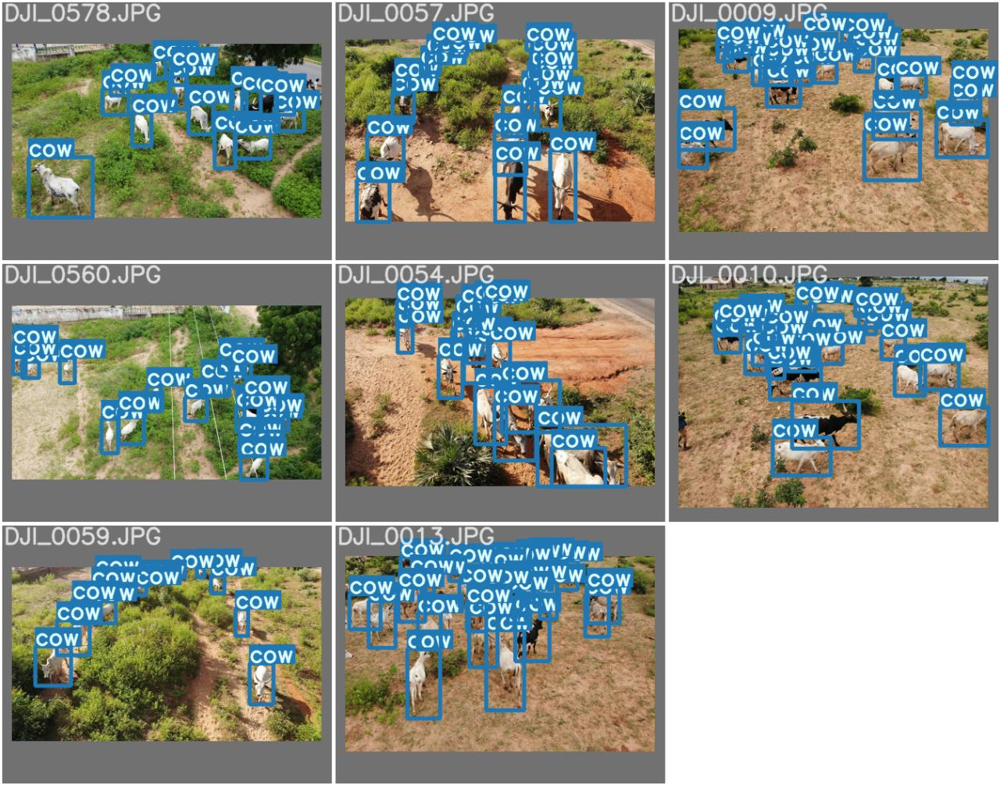

In [74]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch2_labels.jpg", width=600)

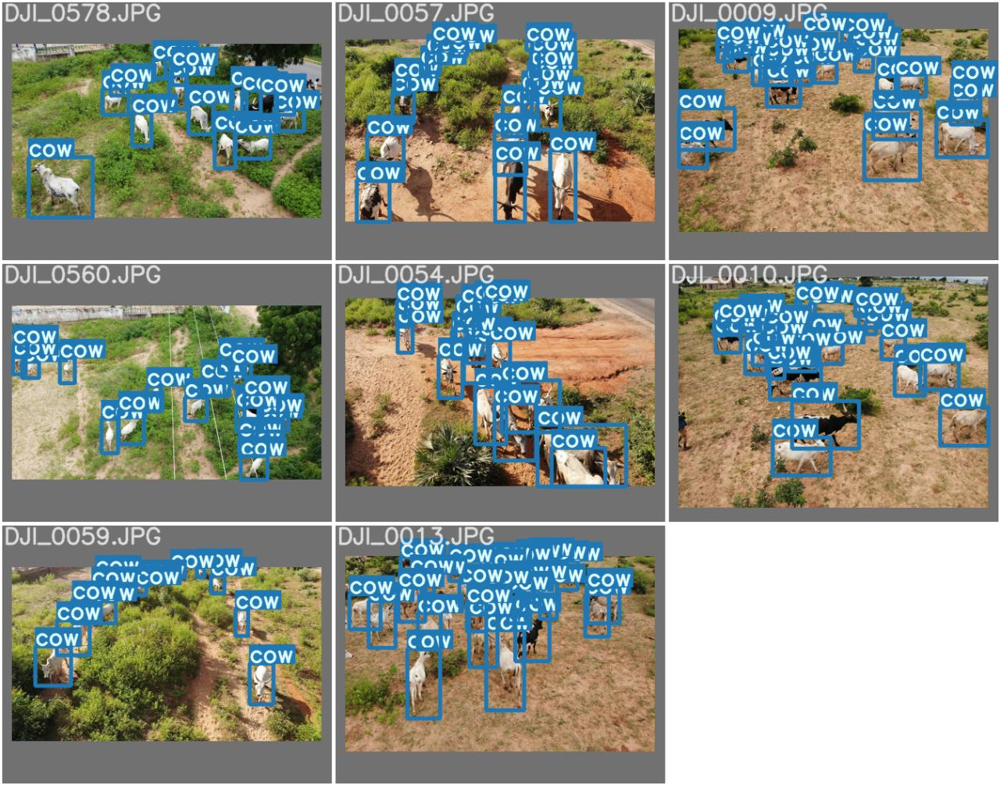

In [75]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch2_labels.jpg", width=600)

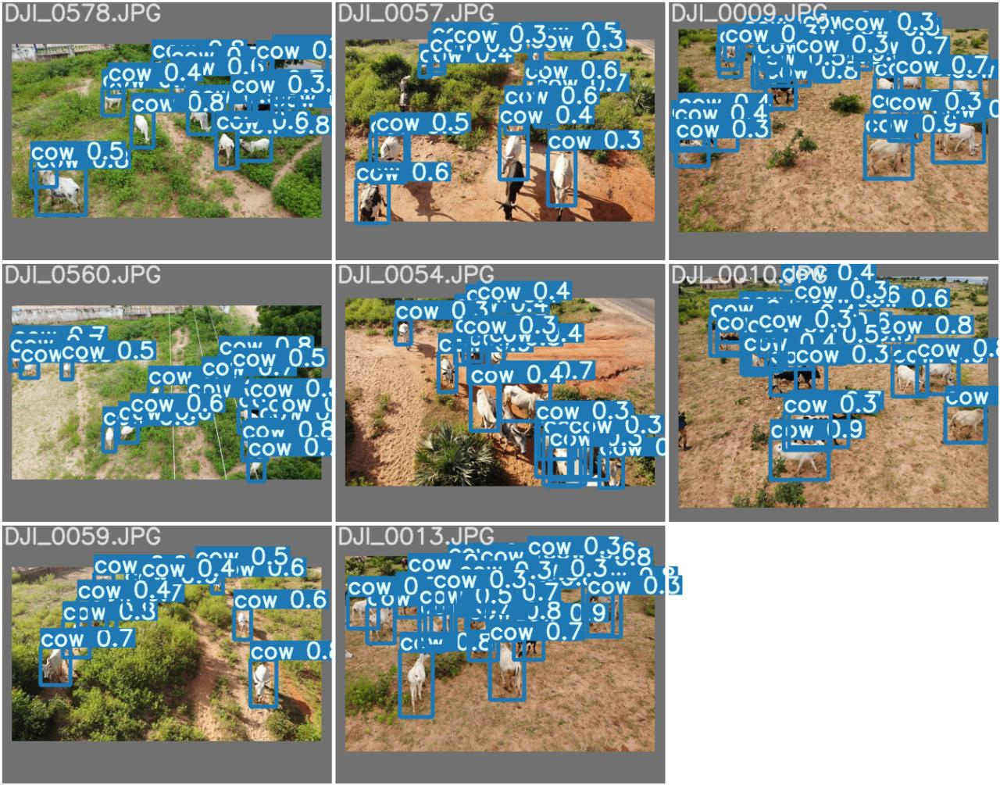

In [76]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/test_batch2_pred.jpg", width=600)

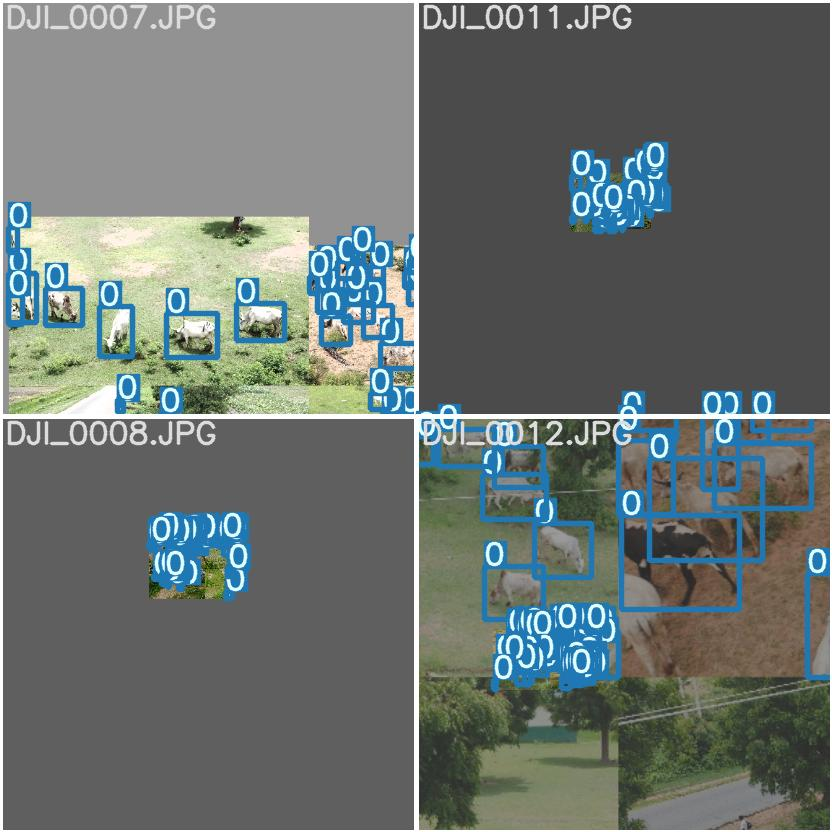

In [77]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/train_batch0.jpg", width=600)

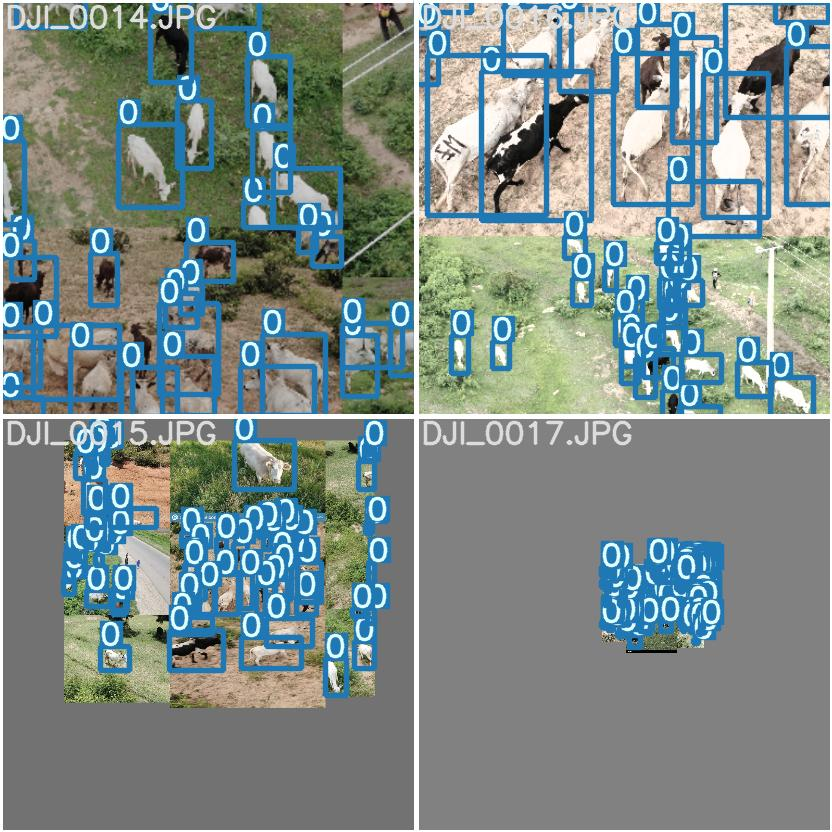

In [78]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/train_batch1.jpg", width=600)

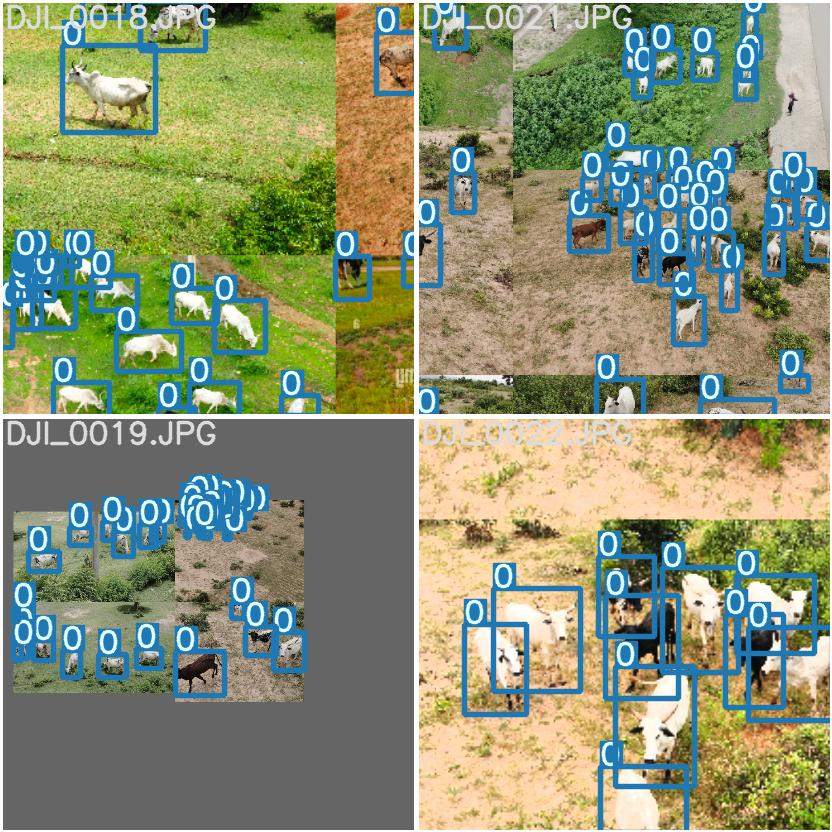

In [79]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/train_batch2.jpg", width=600)

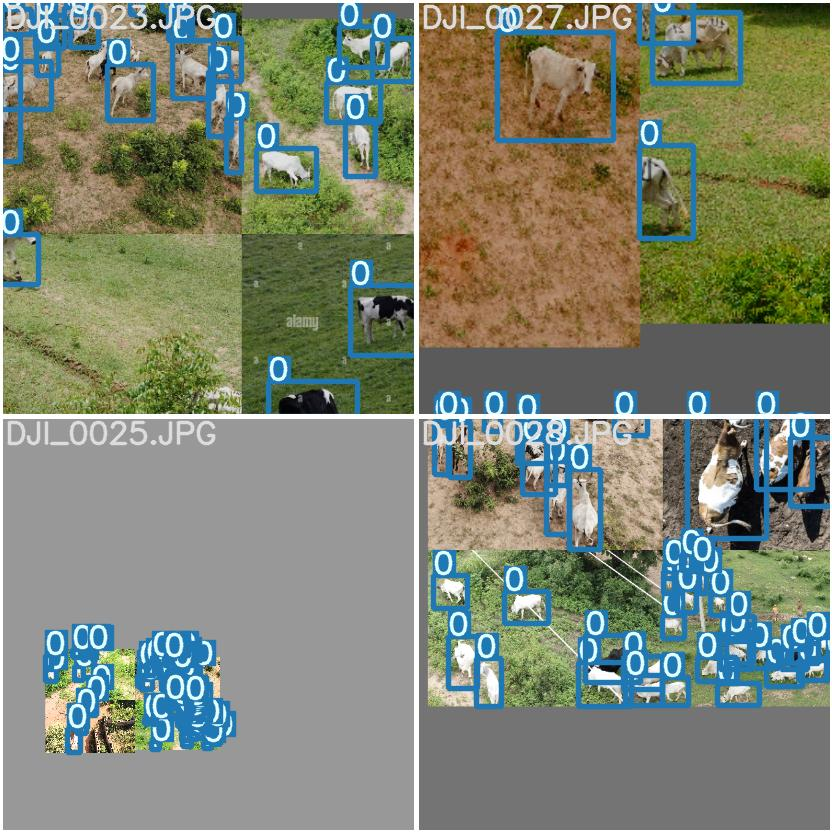

In [80]:
Image("/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/train_batch3.jpg", width=600)

In [81]:
# Ensure we are in the YOLOv5 directory
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025/yolov7')

# Run inference using the modified detect.py script
!python detect.py --weights /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/weights/best.pt --source /content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0012.JPG

Namespace(weights=['/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/weights/best.pt'], source='/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0012.JPG', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40506.8125MB)

/content/drive/MyDrive/LivestockDetection2025/yolov7/models/experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default

In [82]:
# Ensure we are in the YOLOv5 directory
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025/yolov7')

# Run inference using the modified detect.py script
!python detect.py --weights /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/weights/best.pt --source /content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0305.JPG

Namespace(weights=['/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/weights/best.pt'], source='/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0305.JPG', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40506.8125MB)

/content/drive/MyDrive/LivestockDetection2025/yolov7/models/experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default

In [83]:
# Ensure we are in the YOLOv5 directory
import os
os.chdir('/content/drive/MyDrive/LivestockDetection2025/yolov7')

# Run inference using the modified detect.py script
!python detect.py --weights /content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/weights/best.pt --source /content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0450.JPG

Namespace(weights=['/content/drive/MyDrive/LivestockDetection2025/yolov7/runs/train/yolov77/weights/best.pt'], source='/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0450.JPG', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40506.8125MB)

/content/drive/MyDrive/LivestockDetection2025/yolov7/models/experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default